 # Análise de Acidentes de Trânsito em Porto Alegre 🚦

Este projeto tem como objetivo realizar uma análise exploratória dos acidentes de Trânsito
em Porto Alegre, identificando padrões temporais e espaciais que possam apoiar estratégias de prevenção.

#### Fontes dos Dados 
https://dadosabertos.poa.br/dataset/acidentes-de-transito-acidentes


#### Objetivos principais :
- Explorar os dados de acidentes em Porto Alegre
- Identificar os período e locais mais críticos
- Gerar insight que possam apoiar políticas públicas e conscientização.

## 1.Importação e Visualização inicial  📥 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Carregando o dataframe que utilizaremos na análise.
df = pd.read_csv('E:\Projeto_anaconda\dadosACD\cat_acidentes.csv', sep = ';')

In [3]:
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-08-01 01:32:56,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-08-01 01:32:56,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-08-01 01:32:56,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-08-01 01:32:56,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-08-01 01:32:56,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73420,2025-08-01 01:32:56,226.0,0.0,2025-05-24 00:00:00,0,0,0,0,0,0,...,-51.169479,-30.077303,R ANTONIO SIMOES,NaN,CHOQUE,SÁBADO,08:50:00.0000000,DIA,LESTE,NaN
73421,2025-08-01 01:32:56,3745.0,0.0,2025-05-19 00:00:00,0,0,0,0,0,1,...,-51.198652,-30.000108,AV FARRAPOS,AV SERTORIO,COLISÃO,SEGUNDA-FEIRA,08:25:00.0000000,DIA,NORTE,NaN
73422,2025-08-01 01:32:56,4655.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.191917,-29.997267,AV FARRAPOS,R VINTE CINCO DE FEVEREIRO,COLISÃO,QUARTA-FEIRA,18:10:00.0000000,NOITE,NORTE,NaN
73423,2025-08-01 01:32:56,2624.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.169690,-30.021052,R ANITA GARIBALDI,NaN,COLISÃO,QUARTA-FEIRA,14:40:00.0000000,DIA,NORTE,NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73425 entries, 0 to 73424
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   data_extracao  73425 non-null  object 
 1   predial1       69052 non-null  float64
 2   queda_arr      73425 non-null  float64
 3   data           73425 non-null  object 
 4   feridos        73425 non-null  int64  
 5   feridos_gr     73425 non-null  int64  
 6   mortes         73425 non-null  int64  
 7   morte_post     73425 non-null  int64  
 8   fatais         73425 non-null  int64  
 9   auto           73425 non-null  int64  
 10  taxi           73425 non-null  int64  
 11  lotacao        73425 non-null  int64  
 12  onibus_urb     73425 non-null  int64  
 13  onibus_met     73425 non-null  int64  
 14  onibus_int     73425 non-null  int64  
 15  caminhao       73425 non-null  int64  
 16  moto           73425 non-null  int64  
 17  carroca        73425 non-null  int64  
 18  bicicl

# 2.Limpeza e Preparo de Dados
- Limpeza de valores NaN
- Padronização das colunas
  

In [5]:
df = df.rename(columns={'noite_dia': 'periodo'})
# Mudei o nome da coluna "noite_dia" para "periodo", para que seja mais fácil de se manipular

In [6]:
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,periodo,regiao,consorcio
0,2025-08-01 01:32:56,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-08-01 01:32:56,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-08-01 01:32:56,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-08-01 01:32:56,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-08-01 01:32:56,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73420,2025-08-01 01:32:56,226.0,0.0,2025-05-24 00:00:00,0,0,0,0,0,0,...,-51.169479,-30.077303,R ANTONIO SIMOES,NaN,CHOQUE,SÁBADO,08:50:00.0000000,DIA,LESTE,NaN
73421,2025-08-01 01:32:56,3745.0,0.0,2025-05-19 00:00:00,0,0,0,0,0,1,...,-51.198652,-30.000108,AV FARRAPOS,AV SERTORIO,COLISÃO,SEGUNDA-FEIRA,08:25:00.0000000,DIA,NORTE,NaN
73422,2025-08-01 01:32:56,4655.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.191917,-29.997267,AV FARRAPOS,R VINTE CINCO DE FEVEREIRO,COLISÃO,QUARTA-FEIRA,18:10:00.0000000,NOITE,NORTE,NaN
73423,2025-08-01 01:32:56,2624.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.169690,-30.021052,R ANITA GARIBALDI,NaN,COLISÃO,QUARTA-FEIRA,14:40:00.0000000,DIA,NORTE,NaN


In [7]:
# Nessa parte limpamos os valores nulos que estavam nas colunas "longitude" e "latitude"
df = df.dropna(subset=['longitude', 'latitude'], how = 'any' )
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,periodo,regiao,consorcio
0,2025-08-01 01:32:56,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
4,2025-08-01 01:32:56,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
6,2025-08-01 01:32:56,11000.0,0.0,2020-01-02 00:00:00,1,1,0,0,0,2,...,-51.114792,-29.975967,AV ASSIS BRASIL,NaN,COLISÃO,QUINTA-FEIRA,14:15:00.0000000,DIA,NORTE,NaN
8,2025-08-01 01:32:56,1028.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,2,...,-51.180252,-30.037807,AV BAGE,AV PALMEIRA,ABALROAMENTO,QUINTA-FEIRA,21:30:00.0000000,NOITE,LESTE,NaN
11,2025-08-01 01:32:56,5800.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,1,...,-51.153991,-30.041495,AV PROTASIO ALVES,AV SATURNINO DE BRITO,ABALROAMENTO,QUINTA-FEIRA,07:10:00.0000000,DIA,LESTE,CARRIS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73420,2025-08-01 01:32:56,226.0,0.0,2025-05-24 00:00:00,0,0,0,0,0,0,...,-51.169479,-30.077303,R ANTONIO SIMOES,NaN,CHOQUE,SÁBADO,08:50:00.0000000,DIA,LESTE,NaN
73421,2025-08-01 01:32:56,3745.0,0.0,2025-05-19 00:00:00,0,0,0,0,0,1,...,-51.198652,-30.000108,AV FARRAPOS,AV SERTORIO,COLISÃO,SEGUNDA-FEIRA,08:25:00.0000000,DIA,NORTE,NaN
73422,2025-08-01 01:32:56,4655.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.191917,-29.997267,AV FARRAPOS,R VINTE CINCO DE FEVEREIRO,COLISÃO,QUARTA-FEIRA,18:10:00.0000000,NOITE,NORTE,NaN
73423,2025-08-01 01:32:56,2624.0,0.0,2025-05-14 00:00:00,0,0,0,0,0,2,...,-51.169690,-30.021052,R ANITA GARIBALDI,NaN,COLISÃO,QUARTA-FEIRA,14:40:00.0000000,DIA,NORTE,NaN


Agora com os dados preparados e organizados podemos começar a nossa análise. Irei começar fazendo uma Análise Geográficas, usando mapas como de calor e de clusters para identificar concentrações de acidentes em Porto Alegre.

# 3.Análise Geográfica 🗺️

In [8]:

import folium
from folium.plugins import HeatMap, MarkerCluster

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
coordenadas = list(zip(df.latitude, df.longitude))
HeatMap(coordenadas, radius=9, blur=10).add_to(mapa)
mapa



No mapa de calor, conseguimos ver que a região central de Porto Alegre é a que concentra mais acidentes, já que aparece como a área mais intensa do mapa.

Para entender melhor essa concentração, vamos usar um mapa de clusters, que ajuda a visualizar de forma mais clara e detalhada onde os acidentes realmente acontecem.

In [9]:
from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1,-51.15], zoom_start=11)
mapa_cluster= MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)
              
mapa



Agora já sabemos quantos acidentes aconteceram no centro de Porto Alegre e nas regiões ao redor. Mas surge uma nova pergunta: em quais anos esses acidentes foram registrados?

## 4.Frequência de Acidentes
Primeiro, vamos examinar o **DataFrame** para identificar de quais anos os dados estão sendo coletados. Essa etapa nos permite ter uma visão geral do período abrangido pelos registros de acidentes.


In [10]:
df.data

0        2020-10-17 00:00:00
4        2020-01-02 00:00:00
6        2020-01-02 00:00:00
8        2020-01-02 00:00:00
11       2020-01-02 00:00:00
                ...         
73420    2025-05-24 00:00:00
73421    2025-05-19 00:00:00
73422    2025-05-14 00:00:00
73423    2025-05-14 00:00:00
73424    2025-05-15 00:00:00
Name: data, Length: 62908, dtype: object

In [11]:
df['data'] = pd.to_datetime(df['data'], errors= 'coerce')
df_ano = df['data'].dt.year.value_counts()
df_ano

C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\2908237305.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['data'] = pd.to_datetime(df['data'], errors= 'coerce')


data
2023    14575
2024    13717
2022    13329
2021    11701
2025     6690
2020     2896
Name: count, dtype: int64

O resultado mostra os anos que os acidentes foram registrados, permitindo identificar os períodos com maior registro de ocorrências.

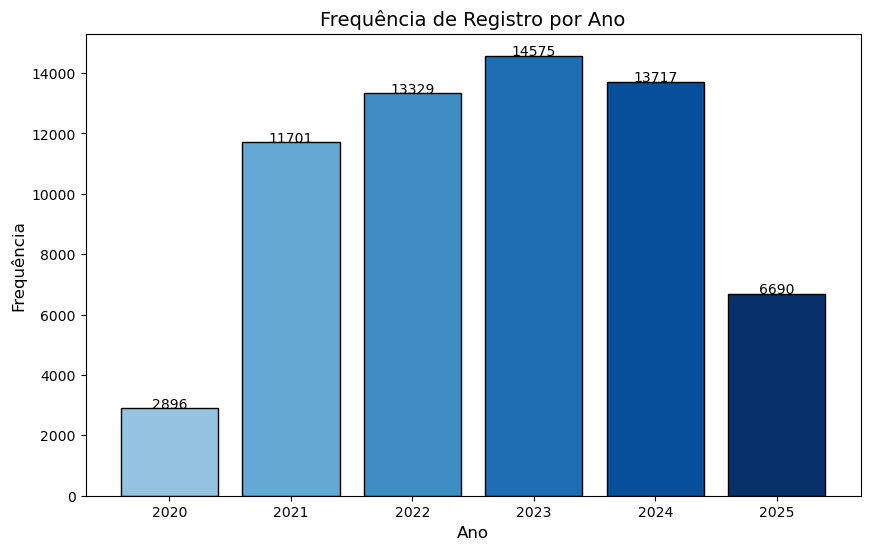

In [12]:
# Gráfico dos Registros por ano de Acidentes
df_ano = df['data'].dt.year.value_counts().sort_index()

anos = df_ano.index
valores = df_ano.values
cores = plt.cm.Blues(np.linspace(0.4,1, len(anos)))

plt.figure(figsize=(10,6))
plt.bar(anos, valores, color=cores, edgecolor = 'black')
plt.title('Frequência de Registro por Ano', fontsize=14)
plt.xlabel("Ano", fontsize=12)
plt.ylabel("Frequência", fontsize=12)

for i, v in enumerate(valores):
    plt.text(anos[i], v + 1, str(v), ha='center', fontsize=10)


plt.show()

Agora sabemos quais anos estão registrados no **DataFrame** e podemos ter uma noção da quantidade de acidentes por ano.  
Observa-se que **2023** foi o ano com o maior número de registros de acidentes de trânsito, indicando um aumento significativo nesse período.

In [13]:
tabela = df['dia_sem'].value_counts().to_frame(name='frequencia')
tabela.reset_index(inplace=True)
tabela.columns = ['dia_sem', 'frequencia']
tabela

# Esta tabela nos permite visualizar quais dias da semana apresentam maior, frequência de acidentes.

,dia_sem,frequencia
0,SEXTA-FEIRA,10653
1,QUARTA-FEIRA,10129
2,QUINTA-FEIRA,10125
3,SEGUNDA-FEIRA,10010
4,TERÇA-FEIRA,9908
5,SÁBADO,6983
6,DOMINGO,5100


Observa-se que **sexta-feira** é o dia da semana com maior ocorrência de acidentes nos últimos anos.  
Essa informação pode ser útil para direcionar campanhas de conscientização e medidas de prevenção de acidentes nos dias de maior risco.

In [14]:
dia_sexta = 'SEXTA-FEIRA'
df_filtrado = df[df['dia_sem'] == dia_sexta]

In [15]:
tabela_periodo = df_filtrado['periodo'].value_counts().to_frame(name = 'quantidade')
tabela_periodo.reset_index(inplace=True)
tabela_periodo.columns = ['periodo', 'quantidade']

tabela_periodo
# A tabela permite comparar a quantidade de acidentes durante o dia e à noite.

,periodo,quantidade
0,DIA,7551
1,NOITE,3102


Agora que identificamos que a quantidade que mais ocorrem acidentes é no **período do dia**, vamos aprofundar a análise criando um gráfico para visualizar **quais horários apresentam maior frequência de acidentes**.  
Isso nos ajudará a entender melhor os momentos de maior risco no trânsito.

In [16]:
df['hora'].isna().sum
# Checando se a algum valor nulo na coluna "hora" do data frame para não nos prejudicar.

<bound method Series.sum of 0        False
4        False
6        False
8        False
11       False
         ...  
73420    False
73421    False
73422    False
73423    False
73424    False
Name: hora, Length: 62908, dtype: bool>

Existe alguns valores nulos na coluna e iremos retirar-los 

In [17]:
df_hora = df.dropna(subset=['hora'],how = 'any')
df_hora

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,periodo,regiao,consorcio
0,2025-08-01 01:32:56,0.0,0.0,2020-10-17,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
4,2025-08-01 01:32:56,3302.0,0.0,2020-01-02,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
6,2025-08-01 01:32:56,11000.0,0.0,2020-01-02,1,1,0,0,0,2,...,-51.114792,-29.975967,AV ASSIS BRASIL,NaN,COLISÃO,QUINTA-FEIRA,14:15:00.0000000,DIA,NORTE,NaN
8,2025-08-01 01:32:56,1028.0,0.0,2020-01-02,0,0,0,0,0,2,...,-51.180252,-30.037807,AV BAGE,AV PALMEIRA,ABALROAMENTO,QUINTA-FEIRA,21:30:00.0000000,NOITE,LESTE,NaN
11,2025-08-01 01:32:56,5800.0,0.0,2020-01-02,0,0,0,0,0,1,...,-51.153991,-30.041495,AV PROTASIO ALVES,AV SATURNINO DE BRITO,ABALROAMENTO,QUINTA-FEIRA,07:10:00.0000000,DIA,LESTE,CARRIS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73420,2025-08-01 01:32:56,226.0,0.0,2025-05-24,0,0,0,0,0,0,...,-51.169479,-30.077303,R ANTONIO SIMOES,NaN,CHOQUE,SÁBADO,08:50:00.0000000,DIA,LESTE,NaN
73421,2025-08-01 01:32:56,3745.0,0.0,2025-05-19,0,0,0,0,0,1,...,-51.198652,-30.000108,AV FARRAPOS,AV SERTORIO,COLISÃO,SEGUNDA-FEIRA,08:25:00.0000000,DIA,NORTE,NaN
73422,2025-08-01 01:32:56,4655.0,0.0,2025-05-14,0,0,0,0,0,2,...,-51.191917,-29.997267,AV FARRAPOS,R VINTE CINCO DE FEVEREIRO,COLISÃO,QUARTA-FEIRA,18:10:00.0000000,NOITE,NORTE,NaN
73423,2025-08-01 01:32:56,2624.0,0.0,2025-05-14,0,0,0,0,0,2,...,-51.169690,-30.021052,R ANITA GARIBALDI,NaN,COLISÃO,QUARTA-FEIRA,14:40:00.0000000,DIA,NORTE,NaN


In [18]:
df_hora['hora'].isna().sum()
# Agora a coluna está totalmente limpa de valores nulos

np.int64(0)

In [19]:
df_sexta = df[df['dia_sem'] == 'SEXTA-FEIRA']
df_sexta['hora'] = pd.to_datetime(df_sexta['hora'], errors = 'coerce').dt.time
df_sexta['hora_do_dia'] = df_sexta['hora'].apply(lambda x: x.hour)

C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\833552709.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_sexta['hora'] = pd.to_datetime(df_sexta['hora'], errors = 'coerce').dt.time
C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\833552709.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sexta['hora'] = pd.to_datetime(df_sexta['hora'], errors = 'coerce').dt.time
C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\833552709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

In [20]:
bins = list(range(0, 25, 2))
labels = [f'{i}-{i+1}h' for i in bins[:-1]]
df_sexta['intervalo_hora'] = pd.cut(df_sexta['hora_do_dia'], bins=bins, labels=labels, right=False)

acidentes_hora = df_sexta['intervalo_hora'].value_counts().sort_index()
acidentes_hora

# Para entender melhor quantos os acidentes ocorrem durante o dia, dividimos em intervalos de 2 horas e contamos a quantidade de acidentes.

C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\1415719938.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sexta['intervalo_hora'] = pd.cut(df_sexta['hora_do_dia'], bins=bins, labels=labels, right=False)


intervalo_hora
0-1h       192
2-3h        90
4-5h       111
6-7h       750
8-9h      1331
10-11h    1242
12-13h    1319
14-15h    1400
16-17h    1509
18-19h    1414
20-21h     753
22-23h     432
Name: count, dtype: int64

Podemos ver que os intervalos com maior ocorrência de acidentes são ao início do dia **8-9h** e no período da tarde **16-17h**, indicando que os horários de pico do tráfego correspondem a momentos de maior risco de acidentes.
Intervalos da madrugada, como 2-3h e 4-5h, apresentam menor número de acidentes.

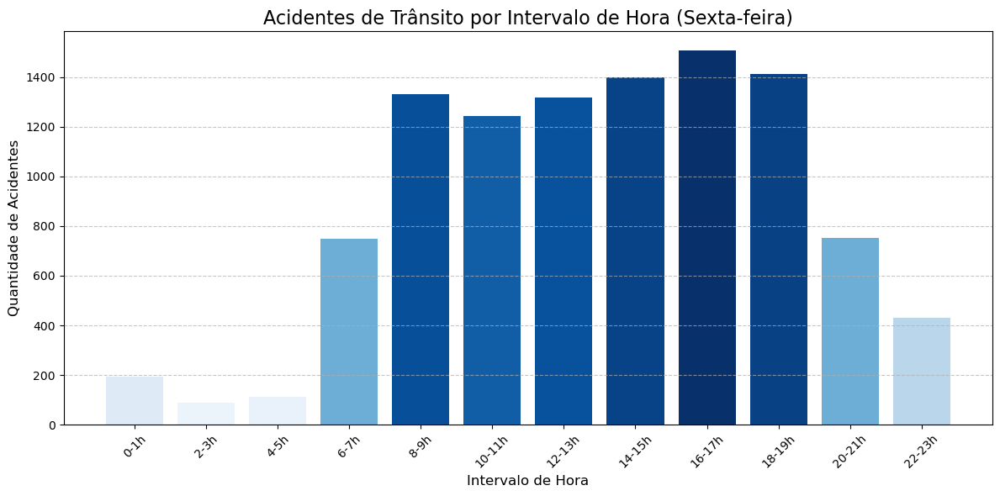

In [21]:
acidentes_hora = acidentes_hora.sort_index()

norm = acidentes_hora.values / acidentes_hora.values.max()
cores = plt.cm.Blues(norm)

plt.figure(figsize=(12,6))
plt.bar(acidentes_hora.index.astype(str), acidentes_hora.values, color=cores)
plt.title("Acidentes de Trânsito por Intervalo de Hora (Sexta-feira)", fontsize=16)
plt.xlabel("Intervalo de Hora", fontsize=12)
plt.ylabel("Quantidade de Acidentes", fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

## 5.Relação entre  variáveis
Nessa etapa,analisamos como os acidentes se distribuem ao longo da semana e em diferentes períodos do dia.

In [22]:
dias_ordem = ['SEGUNDA-FEIRA','TERÇA-FEIRA','QUARTA-FEIRA','QUINTA-FEIRA','SEXTA-FEIRA','SÁBADO','DOMINGO' ]
df['dia_sem'] = pd.Categorical(df['dia_sem'], categories=dias_ordem, ordered=True)

C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\763493484.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dia_sem'] = pd.Categorical(df['dia_sem'], categories=dias_ordem, ordered=True)


In [23]:
# Criei uma tabela para nos mostrar os dias da semana e quantidade de acidentes

tabela_dia_periodo = pd.crosstab(df['dia_sem'], df['periodo'])
tabela_dia_periodo

periodo,DIA,NOITE
dia_sem,,
SEGUNDA-FEIRA,7527,2483
TERÇA-FEIRA,7479,2429
QUARTA-FEIRA,7450,2679
QUINTA-FEIRA,7430,2695
SEXTA-FEIRA,7551,3102
SÁBADO,4342,2641
DOMINGO,2639,2461


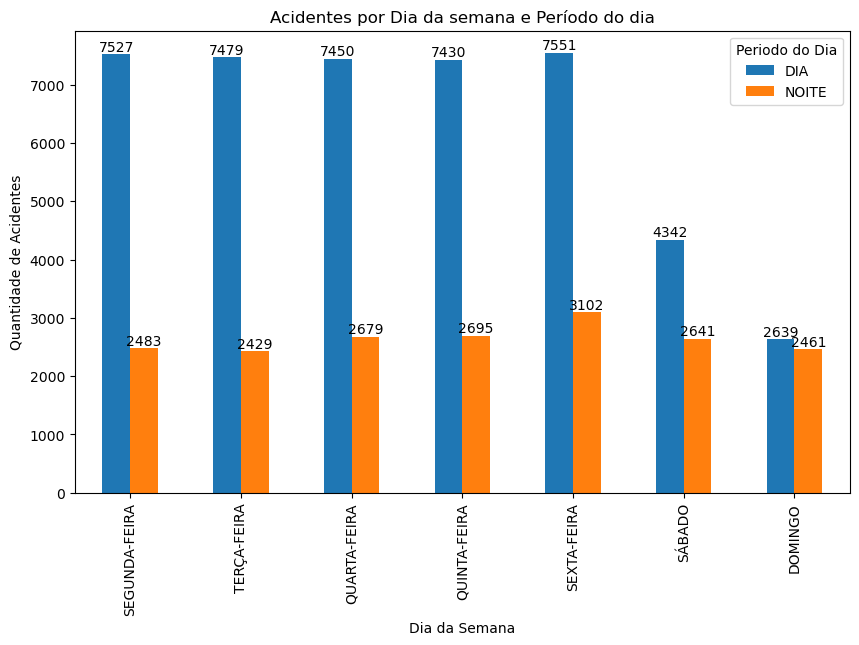

In [24]:
tabela_dia_periodo = pd.crosstab(df['dia_sem'], df['periodo'])

ax = tabela_dia_periodo.plot(kind='bar', figsize=(10,6))
plt.title('Acidentes por Dia da semana e Período do dia')
plt.xlabel('Dia da Semana')
plt.ylabel('Quantidade de Acidentes')
plt.legend(title='Periodo do Dia')

for container in ax.containers:  
    ax.bar_label(container, fmt='%d')

plt.show()

Observando o gráfico, podemos identificar que o período do **dia** são mais frequentes de acidentes. Com por exemplo, notamos que há uma maior concentração de acidentes nos **finais de semana** ou durante o **período da manhã**, pois o fluxo de carros aumenta nesses períodos. Essas informações pode auxiliar no planejamento de campanhas de segurança viária e fiscalização.

# Acidentes por hora e dia da semana
Nesta etapa, analisamos a distribuição dos acidentes ao longo do **dia** em cada **dia da semana**, para identificar quais horários apresentam maior ocorrência de acidentes.

In [25]:
print(df.columns)

Index(['data_extracao', 'predial1', 'queda_arr', 'data', 'feridos',
       'feridos_gr', 'mortes', 'morte_post', 'fatais', 'auto', 'taxi',
       'lotacao', 'onibus_urb', 'onibus_met', 'onibus_int', 'caminhao', 'moto',
       'carroca', 'bicicleta', 'outro', 'cont_vit', 'ups', 'patinete',
       'idacidente', 'longitude', 'latitude', 'log1', 'log2', 'tipo_acid',
       'dia_sem', 'hora', 'periodo', 'regiao', 'consorcio'],
      dtype='object')


In [26]:
print(df['dia_sem'].unique())

['SÁBADO', 'QUINTA-FEIRA', 'SEXTA-FEIRA', 'DOMINGO', 'QUARTA-FEIRA', 'SEGUNDA-FEIRA', 'TERÇA-FEIRA']
Categories (7, object): ['SEGUNDA-FEIRA' < 'TERÇA-FEIRA' < 'QUARTA-FEIRA' < 'QUINTA-FEIRA' < 'SEXTA-FEIRA' < 'SÁBADO' < 'DOMINGO']


In [27]:
print(df['periodo'].unique())

['NOITE' 'DIA']


In [28]:
dias_ordem = ['SEGUNDA-FEIRA','TERÇA-FEIRA','QUARTA-FEIRA','QUINTA-FEIRA','SEXTA-FEIRA','SÁBADO','DOMINGO' ]
df['dia_sem'] = pd.Categorical(df['dia_sem'], categories=dias_ordem, ordered=True)

C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\763493484.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['dia_sem'] = pd.Categorical(df['dia_sem'], categories=dias_ordem, ordered=True)


In [29]:
# Criando uma tabela cruzada entre hora e dia da semana
tabela_dia_periodo = pd.crosstab(df['dia_sem'],df['periodo'])
tabela_dia_periodo

periodo,DIA,NOITE
dia_sem,,
SEGUNDA-FEIRA,7527,2483
TERÇA-FEIRA,7479,2429
QUARTA-FEIRA,7450,2679
QUINTA-FEIRA,7430,2695
SEXTA-FEIRA,7551,3102
SÁBADO,4342,2641
DOMINGO,2639,2461


C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\1703137458.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['hora'] = pd.to_datetime(df['hora'], errors='coerce')
C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\1703137458.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hora'] = pd.to_datetime(df['hora'], errors='coerce')
C:\Users\Wender Santos\AppData\Local\Temp\ipykernel_13340\1703137458.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation

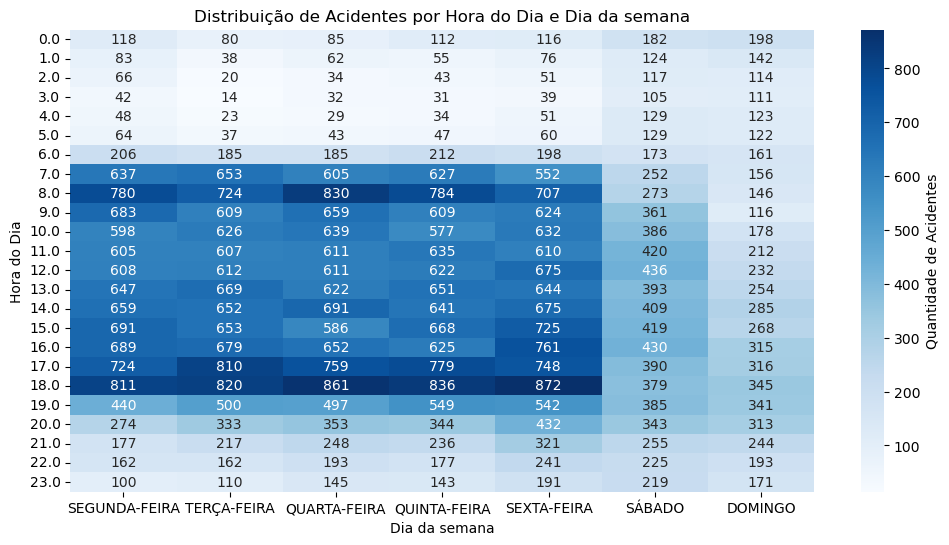

In [30]:
df['hora'] = pd.to_datetime(df['hora'], errors='coerce')
df['hora_int'] = df['hora'].dt.hour

tabela_hora_dia = pd.crosstab(df['hora_int'], df['dia_sem'])

plt.figure(figsize=(12,6))
sns.heatmap(
    tabela_hora_dia,
    cmap='Blues',
    annot = True,
    fmt='d',
    cbar_kws={'label': 'Quantidade de Acidentes'} 
)

plt.title('Distribuição de Acidentes por Hora do Dia e Dia da semana')
plt.xlabel('Dia da semana')
plt.ylabel('Hora do Dia')
plt.show()
                

O heatmap permite visualizar os picos de acidentes em horários específicos. Podemos ver claramente quais horários são mais críticos em cada dia da semana, com destaque para 07:00 e 08:00 da manhã e 18:00 às 19:00 da noite, que concentram maior número de acidentes. Essa informação é fundamental para planejar campanhas de conscientização e estratégias de fiscalização.

# Conclusão

Ao longo deste projeto, realizamos uma análise exploratória dos acidentes, observando sua distribuição por **dia da semana**, **período do dia** e **hora do dia**. Alguns pontos importantes foram identificados:

- Os acidentes apresentam maior ocorrência em determinados dias e horários, com destaque para **07:00 e 08:00 da manhã** e **18:00 às 19:00 da noite**, indicando horários críticos, possivelmente relacionados ao fluxo intenso de trânsito para ida e volta de trabalho.
- A análise por dia da semana mostrou padrões de maior incidência nos dias de maior movimento, especialmente **sextas-feiras** e períodos próximos ao final da semana.
- A distribuição por período e hora permite direcionar ações de conscientização, fiscalização e políticas públicas para reduzir o número de acidentes.

Esses insights são fundamentais para **planejar estratégias de prevenção**, identificar áreas e horários críticos, e auxiliar na tomada de decisões por órgãos de trânsito e gestores urbanos.
